<a href="https://colab.research.google.com/github/amaskaa/ML/blob/Breast-Cancer-Detection/Breast_Cancer_Detection_Project_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd # for data manupulation or analysis
import numpy as np # for numeric calculation
import matplotlib.pyplot as plt # for data visualization
import seaborn as sns # for data visualization

In [ ]:
#Load breast cancer dataset
from sklearn.datasets import load_breast_cancer
cancer_dataset = load_breast_cancer()
# cancer_dataset
type(cancer_dataset)

sklearn.utils.Bunch

In [ ]:
print(cancer_dataset['filename'])

breast_cancer.csv


In [ ]:
cancer_df = pd.DataFrame(np.c_[cancer_dataset['data'],cancer_dataset['target']],
             columns = np.append(cancer_dataset['feature_names'], ['target']))
cancer_df.head()
# cancer_dataset['data']

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,0.0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,0.0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,0.0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,0.0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,0.0


In [ ]:
sns.pairplot(cancer_df,hue='target')

C:\Users\User\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='target', ylabel='count'>

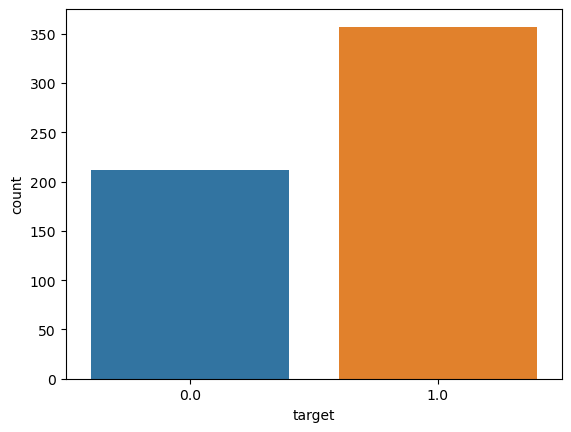

In [ ]:
# Count the target class
sns.countplot(cancer_df['target'])

<AxesSubplot:>

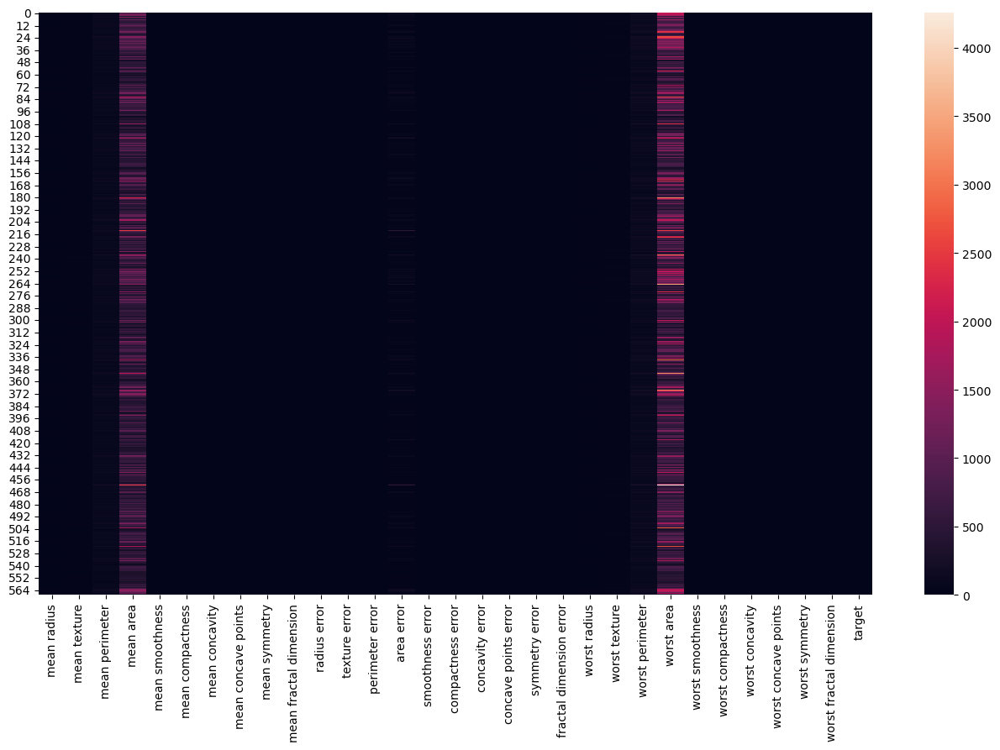

In [ ]:
plt.figure(figsize=(16,9))
sns.heatmap(cancer_df)

In [ ]:
x=cancer_df.iloc[:,:-1]
# print(x)
y=cancer_df.iloc[:,-1]
print(y)

0      0.0
1      0.0
2      0.0
3      0.0
4      0.0
      ... 
564    0.0
565    0.0
566    0.0
567    0.0
568    1.0
Name: target, Length: 569, dtype: float64


In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state= 5)

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train_sc = sc.fit_transform(X_train)
X_test_sc = sc.transform(X_test)

X_test_sc

array([[ 0.35821026,  1.45777268,  0.46038842, ...,  1.41704202,
         1.95548699,  0.86738493],
       [-0.49928428,  0.73941263, -0.48944655, ..., -0.46887783,
        -1.03986272,  0.41799227],
       [ 0.12645498, -1.92911834,  0.11836359, ...,  0.15986649,
         0.01762003, -0.19100836],
       ...,
       [ 1.2301895 , -0.11790888,  1.14275323, ...,  0.70782593,
         0.55743007, -0.79548111],
       [-0.76580285,  0.30604131, -0.58506187, ...,  2.27968674,
         6.40168261,  5.06926289],
       [ 0.95208316,  0.93725605,  0.82263147, ..., -0.46245888,
        -0.7265345 , -1.03489307]])

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

# KNN

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn_classifier2 = KNeighborsClassifier(n_neighbors = 5, metric = 'minkowski', p = 2)
knn_classifier2.fit(X_train_sc, y_train)
y_pred_knn_sc = knn_classifier2.predict(X_test_sc)
accuracy_score(y_test, y_pred_knn_sc)

0.9649122807017544

# Naive Baiyes

In [ ]:
from sklearn.naive_bayes import GaussianNB
nb_classifier2 = GaussianNB()
nb_classifier2.fit(X_train_sc, y_train)
y_pred_nb_sc = nb_classifier2.predict(X_test_sc)
accuracy_score(y_test, y_pred_nb_sc)

0.9385964912280702

# XGBoost

In [1]:
! pip install xgboost
import xgboost as xgb
from xgboost import XGBClassifier
xgb_classifier2 = XGBClassifier()
xgb_classifier2.fit(X_train_sc, y_train)
y_pred_xgb_sc = xgb_classifier2.predict(X_test_sc)
accuracy_score(y_test, y_pred_xgb_sc)

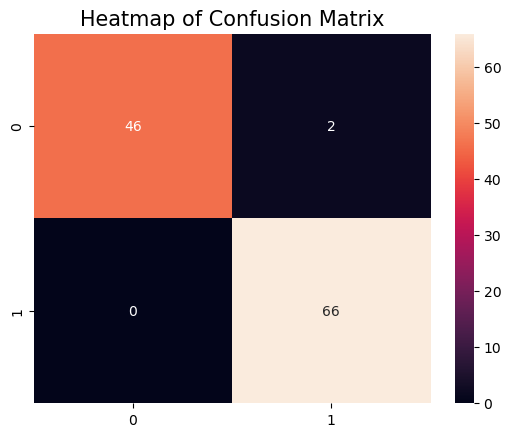

In [ ]:
cm = confusion_matrix(y_test, y_pred_xgb_sc)
plt.title('Heatmap of Confusion Matrix', fontsize = 15)
sns.heatmap(cm, annot = True)
plt.show()

In [ ]:
print(classification_report(y_test, y_pred_xgb_sc))

              precision    recall  f1-score   support

         0.0       1.00      0.96      0.98        48
         1.0       0.97      1.00      0.99        66

    accuracy                           0.98       114
   macro avg       0.99      0.98      0.98       114
weighted avg       0.98      0.98      0.98       114

